In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.animation import FuncAnimation
from matplotlib import animation, rc
import time
import random
from enum import Enum
import sklearn.metrics.pairwise
import scipy.spatial.distance
from google.colab import files
from scipy.integrate import odeint
from sklearn.neighbors import DistanceMetric
from matplotlib.cm import ScalarMappable

## Intialisation

In [ ]:
# Time Constant of both excitatory and inhibitory neurons
TAU = 0.01

# Typically in the neocortex the ratio of Ex and Inh neurons is 80-20
# number of excitatory neurons
NE = 400

# number of inhibitory neurons
NI = 100

# total number of neurons
N = NE + NI

# External input. it can be DC as you have used now. But ideally we are interested in noise.
# In that case eta will be mean/std of a distribution from which we can drawn an instantaneous value of the input
ETA = 5.5

# the initialized firing rates will be randomized between 0 and MAX_INIT_RATE
MAX_INIT_RATE = 5

# width of the toroid
SPACE_WIDTH = 300

# height of the toroid
SPACE_HEIGHT = SPACE_WIDTH

# variance for the gaussian
# Sigma for both exc and inh
# calculate in terms of toroid dimensions
SIGMA_EXH = SPACE_WIDTH / 25.0
SIGMA_INH = SPACE_WIDTH / 10.0

INH_STRENGTH = -18.0
EXH_STRENGTH = 3.

# use constant seed for random operations
USE_CONSTANT_SEED = True


class Neuron(Enum):
  INHIBITORY = 1
  EXCITATORY = 2


def initialize():
  if (not USE_CONSTANT_SEED):
    np.random.seed(np.int64(time.time()))
  else:
    np.random.seed(0)
    random.seed(0)

  global W, R, space, neuron_coordinate, neuron_polarity, x1_cordinates, x2_cordinates
  neuron_polarity_exh = [Neuron.EXCITATORY for i in range(NE)]
  neuron_polarity_inh = [Neuron.INHIBITORY for i in range(NI)]
  neuron_polarity = neuron_polarity_exh + neuron_polarity_inh


  W = np.zeros((N, N))
  R = np.random.rand(N) * MAX_INIT_RATE

  space = np.full((SPACE_HEIGHT, SPACE_WIDTH), -1, dtype=int)
  neuron_coordinate = np.zeros(N, dtype=object)

  # place neurons in the space
  for i in range(N):
    while (True):
      x1 = random.randint(0, SPACE_HEIGHT - 1)
      x2 = random.randint(0, SPACE_WIDTH - 1)

      if(space[x1, x2] == -1):
        space[x1, x2] = i
        neuron_coordinate[i] = np.array([x1, x2])
        break

  x1_cordinates = [x[0] for x in neuron_coordinate]
  x2_cordinates = [x[1] for x in neuron_coordinate]

  # Largest possible value to get from the normal distributions
  largest_value = get_exh_connection_prob([1.0, 1.0], [1.0, 1.0])

  # create connections between neurons
  for i in range(neuron_coordinate.shape[0]):
    for j in range(i + 1, neuron_coordinate.shape[0]):
      inh_connection_prob = get_inh_connection_prob(neuron_coordinate[i], neuron_coordinate[j])
      exh_connection_prob = get_exh_connection_prob(neuron_coordinate[i], neuron_coordinate[j])

      # Scaling the probabilies
      scaled_inh_connection_prob = inh_connection_prob / largest_value + 0.1
      scaled_exh_connection_prob = exh_connection_prob / largest_value + 0.1

      if (neuron_polarity[i] == Neuron.INHIBITORY and neuron_polarity[j] == Neuron.INHIBITORY):
        #prob_atleast_one_connection = 1.0 - ((1.0 - scaled_inh_connection_prob) * (1.0 - scaled_inh_connection_prob ))
        prob_atleast_one_connection = scaled_inh_connection_prob + scaled_inh_connection_prob

        if (prob_atleast_one_connection > random.random()):
          if (random.random() > 0.5):
            W[i, j] = INH_STRENGTH
          else:
            W[j, i] = INH_STRENGTH

      elif (neuron_polarity[i] == Neuron.INHIBITORY and neuron_polarity[j] == Neuron.EXHITORY):
        #prob_atleast_one_connection = 1.0 - ((1.0 - scaled_exh_connection_prob) * (1.0 - scaled_inh_connection_prob))
        prob_atleast_one_connection = scaled_inh_connection_prob + scaled_exh_connection_prob

        if (prob_atleast_one_connection > random.random()):
          if (scaled_exh_connection_prob / (scaled_inh_connection_prob + scaled_exh_connection_prob) > random.random()):
            W[i, j] = EXH_STRENGTH
          else:
            W[j, i] = INH_STRENGTH

      elif (neuron_polarity[i] == Neuron.EXCITATORY and neuron_polarity[j] == Neuron.INHIBITORY):
        #prob_atleast_one_connection = 1.0 - ((1.0 - scaled_exh_connection_prob) * (1.0 - scaled_inh_connection_prob))
        prob_atleast_one_connection = scaled_inh_connection_prob + scaled_exh_connection_prob

        if (prob_atleast_one_connection > random.random()):
          if (scaled_exh_connection_prob / (scaled_inh_connection_prob + scaled_exh_connection_prob) > random.random()):
            W[j, i] = EXH_STRENGTH
          else:
            W[i, j] = INH_STRENGTH

      elif (neuron_polarity[i] == Neuron.EXCITATORY and neuron_polarity[j] == Neuron.EXCITATORY):
        #prob_atleast_one_connection = 1.0 - ((1.0 - scaled_exh_connection_prob) * (1.0 - scaled_exh_connection_prob))
        prob_atleast_one_connection = scaled_exh_connection_prob + scaled_exh_connection_prob

        if (prob_atleast_one_connection > random.random()):
          if (random.random() > 0.5):
            W[i, j] = EXH_STRENGTH
          else:
            W[j, i] = EXH_STRENGTH


def get_inh_connection_prob(x1, x2):
  return gaussian(x1, x2, SIGMA_INH)

def get_exh_connection_prob(x1, x2):
  return gaussian(x1, x2, SIGMA_EXH)

def gaussian(x1, x2, sigma):
  line = np.zeros(2, dtype=int)
  if (np.linalg.norm(x1[0] - x2[0]) < (SPACE_HEIGHT - np.linalg.norm(x1[0] - x2[0]))):
    line[0] = x1[0] - x2[0]
  else:
    line[0] = (SPACE_HEIGHT) - np.linalg.norm(x1[0] - x2[0])

  if (np.linalg.norm(x1[1] - x2[1]) < (SPACE_WIDTH - np.linalg.norm(x1[1] - x2[1]))):
    line[1] = x1[1] - x2[1]
  else:
    line[1] = SPACE_WIDTH - np.linalg.norm(x1[1] - x2[1])

  co = 1.0 / (2 * np.pi * sigma ** 2)

  return co * np.exp((-1.0 / 2.0) * ((line[0] / sigma) ** 2.0 + (line[1] / sigma) ** 2.0))

def gaussian_old(x1, x2, sigma):
    line = np.zeros(2, dtype=int)
    if (np.linalg.norm(x1[0] - x2[0]) < (SPACE_HEIGHT - np.linalg.norm(x1[0] - x2[0]))):
      line[0] = x1[0] - x2[0]
    else:
      line[0] = (SPACE_HEIGHT) - np.linalg.norm(x1[0] - x2[0])

    if (np.linalg.norm(x1[1] - x2[1]) < (SPACE_WIDTH - np.linalg.norm(x1[1] - x2[1]))):
      line[1] = x1[1] - x2[1]
    else:
      line[1] = SPACE_WIDTH - np.linalg.norm(x1[1] - x2[1])

    return np.exp((-np.linalg.norm(line) ** 2) / (2 * sigma ** 2))




## Simulation Implementation

In [ ]:
class Circle:
  def __init__(self, x1, x2, radius):
    self.x1 = x1
    self.x2 = x2
    self.radius = radius

def slow_diffusive_feedback(rate_corr):
  global W

  # matrix to accumulate the changes for each circle area in W
  W_acc_change = np.zeros((N, N))

  # iterate through all areas that are exposed to slow diffusive feedback
  for i in range(len(diffusion_areas)):
    c = diffusion_areas[i]

    W_copy = np.copy(W)
    W_exc = W_copy[:,0:NE]

    w_con = W_exc
    w_con[w_con>0.] = 1 # 1 if there is a connection, 0 otherwise

    for i in range(NE):
      # Check if the neuron is outside the circle area. TODO: can be optimized to do once
      if ((x1_cordinates[i] - c.x1) ** 2 + (x2_cordinates[i] - c.x2) ** 2 > c.radius ** 2):
        w_con[:, i] = 0. # if outside

    w_change = w_con[:,0:NE] * rate_corr[:,0:NE] # keep the correlation only for connected paira

    # accumulate changes in W from one circle area
    W_acc_change[:,0:NE] = W_acc_change[:, 0:NE] + w_change

  W = W + W_acc_change*2. # change the global W


# Neuron transfer function
def sigmoid(input):
    return 1.0 / (1.0 + np.exp(3.0 - input))

initialize()

# The areas of slow diffusive feedback
# Look at code cell further down to visualize
c1 = Circle(200.0, 200.0, 50.0)
c2 = Circle(100.0, 100.0, 50.0)
c3 = Circle(75.0, 225.0, 50.0)
diffusion_areas = [c1, c2, c3]

#Time step (in ms)
h = 0.1 # ms

# Duration of the simulation (in ms)
max_time = 1000. # ms

# time constats of the neurons (in ms)
tau = np.ones((N,1))*10.

# Time axis
t = np.arange(0, max_time, h)

# Initialize the variable
rate = np.zeros((N,len(t)))

input_mean = 15. # np.range(5,30.,5.)
input_std = 10.  # np.range(1,20.,3.)


def run_simulation(use_slow_diffusion):
  initialize()

  rate_tmp = np.zeros((N,1))
  ed_corr = [-1.0, -0.8, -0.6, -0.4, -0.2, 0.0, 0.2, 0.4, 0.6, 0.8, 1.0]

  nn = -1
  corr_hist = np.zeros((40,len(ed_corr)-1))
  corr_time = np.zeros(40)
  for ii in range(0, len(t)-1):
    # Euler's method
    noise_input = np.random.normal(input_mean,input_std,(N,1))
    rate_tmp[:,0] = rate [:,ii]
    dx_dt = sigmoid(W @ rate_tmp + noise_input)

    rate_new = rate_tmp + (- rate_tmp + dx_dt)/tau
    rate[:,ii+1] = rate_new.flatten()

    # Every 100:th iteration, update W with slow diffusive feedback
    if ii>2000 and ii <4000:
      if (ii % 100 == 99):
        nn=nn+1
        corr_time[nn] = ii
        # Take the 100 most previous (in time) firing rates to calculate correlation
        rate_corr = np.corrcoef(rate[:,ii-99:ii])
        #print(rate_corr)
        hh,edhh = np.histogram(np.reshape(rate_corr,(1,N**2)),ed_corr)
        corr_hist[nn,:] = hh
        if (use_slow_diffusion):
          slow_diffusive_feedback(rate_corr)

## Run Simulation and Plot Firing Rates Over Time With Slow Diffusion

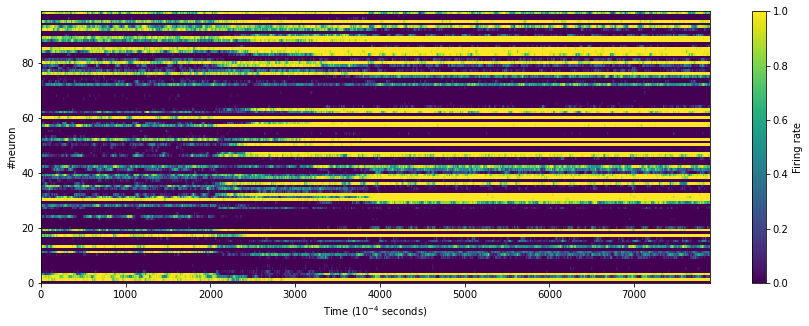

In [ ]:
run_simulation(True)

plt.figure(figsize=(15,5))
plt.pcolor(rate[1:100,100:8000])
colorbar = plt.colorbar()
plt.xlabel("Time ($10^{-4}$ seconds)")
plt.ylabel("#neuron")
colorbar.set_label('Firing rate')

## Run Simulation and Plot Firing Rates Over Time Without Slow Diffusion

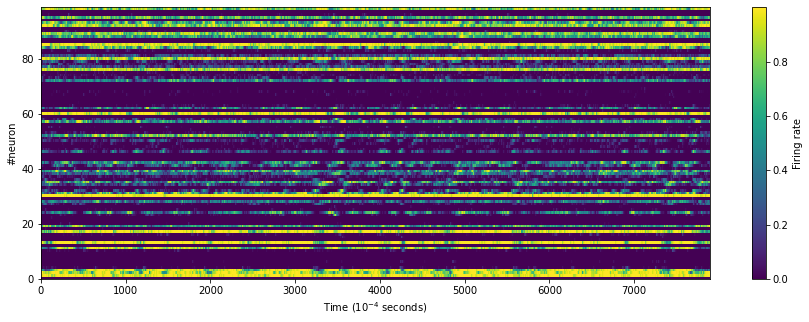

In [ ]:
run_simulation(False)

plt.figure(figsize=(15,5))
plt.pcolor(rate[1:100,100:8000])
colorbar = plt.colorbar()
plt.xlabel("Time ($10^{-4}$ seconds)")
plt.ylabel("#neuron")
colorbar.set_label('Firing rate')

## Neuron Firing Rates by Time With Slow Diffusion

(650.0, 700.0)

<Figure size 432x288 with 0 Axes>

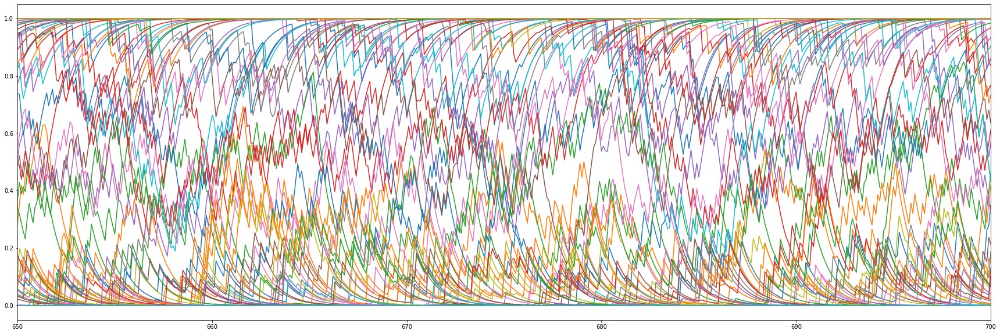

In [ ]:
run_simulation(True)

plt.figure(1)
plt.clf()
plt.figure(figsize=(30,10))
plt.plot(t,rate[10:120,:].T)
plt.xlim((650,700))

## Print Correlations over time

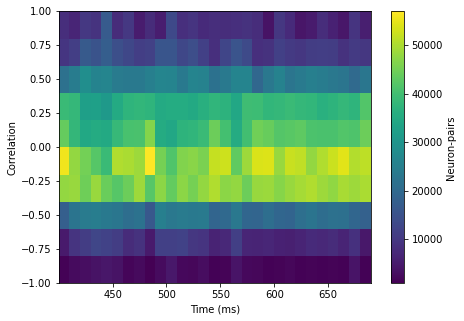

In [ ]:
initialize()
use_slow_diffusion =  True

rate_tmp = np.zeros((N,1))
ed_corr = [-1.0, -0.8, -0.6, -0.4, -0.2, 0.0, 0.2, 0.4, 0.6, 0.8, 1.0]

nn = -1
corr_hist = np.zeros((7000,len(ed_corr)-1))
corr_time = np.zeros(7000)

z = np.zeros((10, 30))

for ii in range(0, len(t)-1):
  # Euler's method
  noise_input = np.random.normal(input_mean,input_std,(N,1))
  rate_tmp[:,0] = rate [:,ii]
  dx_dt = sigmoid(W @ rate_tmp + noise_input)

  rate_new = rate_tmp + (- rate_tmp + dx_dt)/tau
  rate[:,ii+1] = rate_new.flatten()

  # Every 100:th iteration, update W with slow diffusive feedback
  if ii>4000 and ii <7000:
    if (ii % 100 == 99):
      nn=nn+1
      #print(nn)
      corr_time[nn] = ii
      # Take the 100 most previous (in time) firing rates to calculate correlation
      rate_corr = np.corrcoef(rate[:,ii-99:ii])
      hh,edhh = np.histogram(np.reshape(rate_corr,(1,N**2)),ed_corr)
      corr_hist[nn,:] = hh
      #print(hh)
      #if (use_slow_diffusion):
      #  slow_diffusive_feedback(rate_corr)
      z[:, nn] =  hh


plt.figure(figsize=(7,5))
plt.pcolormesh(t[4001:7000:100], ed_corr, z)
plt.xlabel("Time (ms)")
plt.ylabel("Correlation")
colorbar = plt.colorbar()
colorbar.set_label('Neuron-pairs ')



## Slow Diffusive Feeback Areas
Plots the areas where the slow diffusive feedback affects

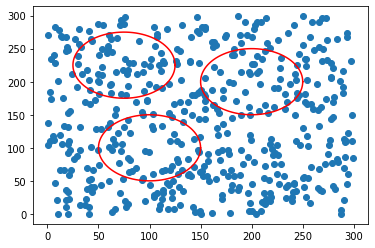

In [ ]:
theta = np.linspace(0, 2*np.pi, 100)
fig, ax = plt.subplots(1)

for i in range(len(diffusion_areas)):
  r = diffusion_areas[i].radius

  x1 = r*np.cos(theta) + diffusion_areas[i].x1
  x2 = r*np.sin(theta) + diffusion_areas[i].x2

  ax.plot(x1, x2, color="red")

ax.scatter(x1_cordinates, x2_cordinates)


## Animation of network

Animation size has reached 20995207 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


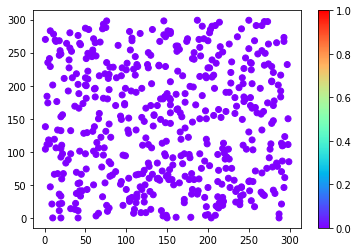

In [ ]:
#time = np.arange(0, 5, 0.001)
#print(time)

#r = odeint(simulate, R, time, args=(W,))

#matplotlib.rcParams['animation.embed_limit'] = 2**128

fig, ax = plt.subplots()
scat = ax.scatter(x1_cordinates, x2_cordinates, c=rate[:, 0],cmap=plt.cm.rainbow, norm=matplotlib.colors.Normalize(vmin=0, vmax=rate.max()))
fig.colorbar(scat, ax=ax)

def animate(i):
    scat.set_color(scat.to_rgba(rate[:, i]))

anim = FuncAnimation(fig, animate, interval=100, frames=len(t[900:1500])-1)

rc('animation', html='jshtml')
anim

## Snapshots from the Animation

(500, 10000)


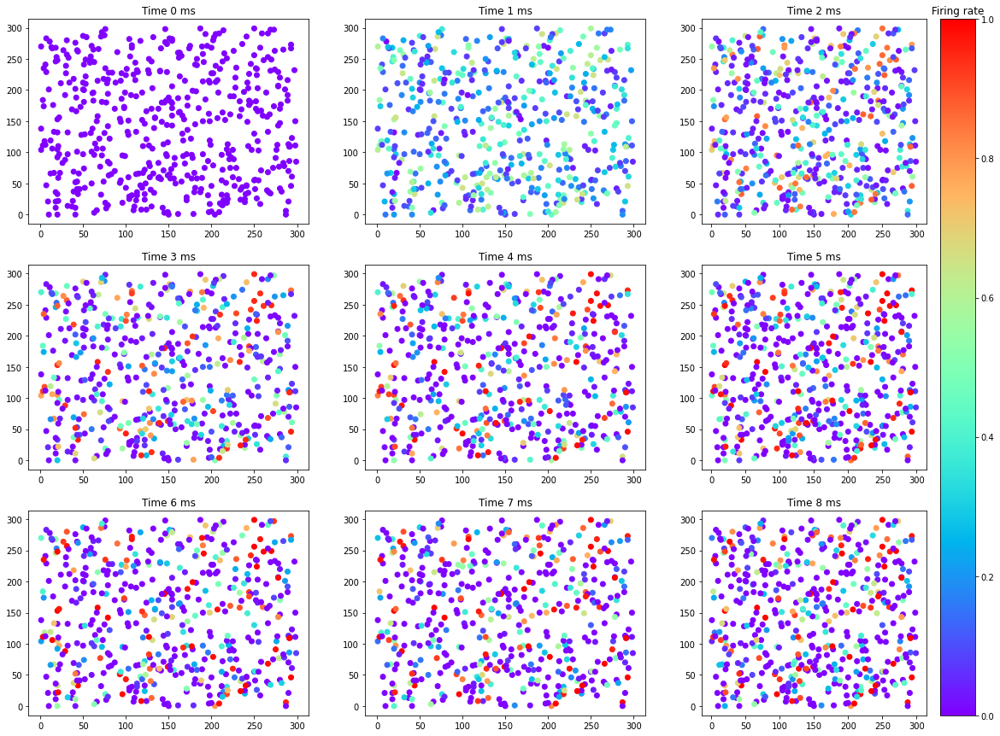

In [ ]:
fig, axes = plt.subplots(3,3, figsize=(20,15))
print(rate.shape)

#fig.figure(figsize=(20,10))

axes[0,0].scatter(x1_cordinates, x2_cordinates, c=rate[:, 0],cmap=plt.cm.rainbow, norm=matplotlib.colors.Normalize(vmin=0, vmax=rate.max()))
axes[0,0].set_title("Time 0 ms")

axes[0,1].scatter(x1_cordinates, x2_cordinates, c=rate[:, 10],cmap=plt.cm.rainbow, norm=matplotlib.colors.Normalize(vmin=0, vmax=rate.max()))
axes[0,1].set_title("Time 1 ms")

axes[0,2].scatter(x1_cordinates, x2_cordinates, c=rate[:, 20],cmap=plt.cm.rainbow, norm=matplotlib.colors.Normalize(vmin=0, vmax=rate.max()))
axes[0,2].set_title("Time 2 ms")

axes[1,0].scatter(x1_cordinates, x2_cordinates, c=rate[:, 30],cmap=plt.cm.rainbow, norm=matplotlib.colors.Normalize(vmin=0, vmax=rate.max()))
axes[1,0].set_title("Time 3 ms")

axes[1,1].scatter(x1_cordinates, x2_cordinates, c=rate[:, 40],cmap=plt.cm.rainbow, norm=matplotlib.colors.Normalize(vmin=0, vmax=rate.max()))
axes[1,1].set_title("Time 4 ms")

axes[1,2].scatter(x1_cordinates, x2_cordinates, c=rate[:, 50],cmap=plt.cm.rainbow, norm=matplotlib.colors.Normalize(vmin=0, vmax=rate.max()))
axes[1,2].set_title("Time 5 ms")

axes[2,0].scatter(x1_cordinates, x2_cordinates, c=rate[:, 60],cmap=plt.cm.rainbow, norm=matplotlib.colors.Normalize(vmin=0, vmax=rate.max()))
axes[2,0].set_title("Time 6 ms")

axes[2,1].scatter(x1_cordinates, x2_cordinates, c=rate[:, 70],cmap=plt.cm.rainbow, norm=matplotlib.colors.Normalize(vmin=0, vmax=rate.max()))
axes[2,1].set_title("Time 7 ms")

axes[2,2].scatter(x1_cordinates, x2_cordinates, c=rate[:, 80],cmap=plt.cm.rainbow, norm=matplotlib.colors.Normalize(vmin=0, vmax=rate.max()))
axes[2,2].set_title("Time 8 ms")


cmap = plt.get_cmap("rainbow")
norm = plt.Normalize(rate.min(), rate.max())
sm =  ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, ax=axes[:,2])
cbar.ax.set_title("Firing rate")

plt.show()

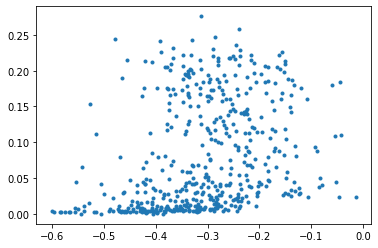

In [ ]:
plt.plot(np.mean(W,1),np.std(rate,1),'.')

## Plot sigmoid function input and output

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,5))

for tick in range(time.shape[0]):
  x_plot = []
  y_plot = []

  for i in range(W.shape[0]):
    x_plot.append(W[i] @ r[tick])
    y_plot.append(sigmoid(W[i] @ r[tick]))

  if (tick == 0):
    ax[0].plot(x_plot, y_plot, "ro")
  elif (tick == 30):
    ax[1].plot(x_plot, y_plot, "ro")
  elif (tick == 60):
    ax[2].plot(x_plot, y_plot, "ro")

plt.show()



## Plot positions of inibitory and excititory neurons on the toroid

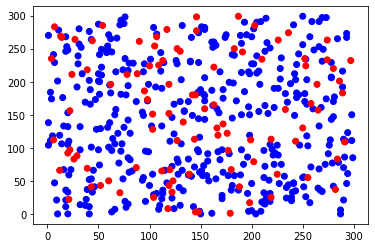

In [ ]:
colors = []
for i in range(neuron_coordinate.shape[0]):
  if (neuron_polarity[i] == Neuron.EXCITATORY):
    colors.append("blue")
  else:
    colors.append("red")

plt.scatter(x1_cordinates, x2_cordinates, c=colors)


## Plot connection probabilities

In [ ]:
colors = []
for i in range(neuron_coordinate.shape[0]):
  if (neuron_polarity[i] == Neuron.EXCITATORY):
    colors.append("yellow")
  else:
    colors.append("red")
z = []

x1_cordinates = [x[0] for x in neuron_coordinate]
x2_cordinates = [x[1] for x in neuron_coordinate]

x1 = np.linspace(0, 299, 300)
x2 = np.linspace(0, 299, 300)

z = np.zeros((SPACE_HEIGHT, SPACE_WIDTH))

for neuron_index in range(neuron_coordinate.shape[0]):
  for i in range(SPACE_HEIGHT):
    for j in range(SPACE_WIDTH):
      cor = np.array([i, j])
      if (neuron_polarity[neuron_index] == Neuron.EXCITATORY):
        z[j, i] += gaussian(neuron_coordinate[neuron_index], cor, SIGMA_EXH)
      else:
        z[j, i] += gaussian(neuron_coordinate[neuron_index], cor, SIGMA_INH)

plt.contourf(x1, x2, z,cmap="Blues")
plt.colorbar()
plt.scatter(x1_cordinates, x2_cordinates, c=colors)


## Plot Connection Matrix

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:20: RuntimeWarning: invalid value encountered in double_scalars


nan
nan


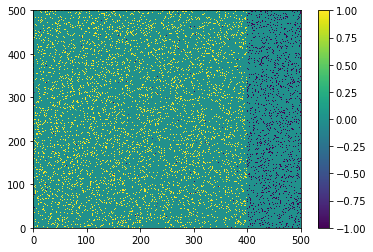

In [ ]:
exh_sum = 0
inh_sum = 0

exh = np.zeros(N)
inh = np.zeros(N)
for i in range(N):
  for j in range(N):
    if (W[i, j] == 1.0):
      exh[i] += 1.0
      exh_sum += 1
    elif (W[i, j] == -5.0):
      inh[i] += 1.0
      inh_sum += 1


average_exh = np.sum(exh) / N
average_inh = np.sum(inh) / N

print(average_exh / (average_exh + average_inh))
print(average_inh / (average_exh + average_inh))


plt.pcolor(W)
plt.colorbar()
plt.clim(-1, 1)

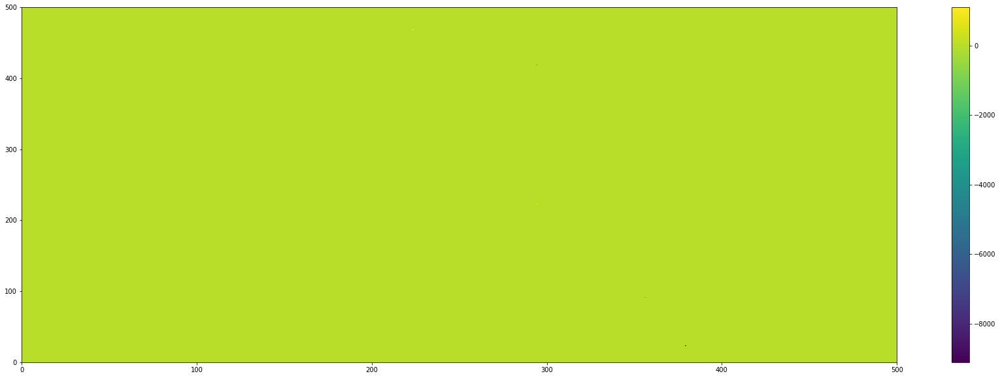

In [ ]:
avg_rate = np.mean(rate[:,100:],1)
np.shape(avg_rate)
rate_corr = np.corrcoef(rate[:,100:])
np.shape(rate_corr)


W_copy = np.copy(W)

W_exc = W_copy[:,0:NE]
we_con = W_exc
we_con[we_con>0.] = 1 # 1 if there is a connection, 0 otherwise

rate_corr = np.corrcoef(rate[:,0:100])

del_w = we_con * rate_corr[:,0:NE] # keep the correlation only for connected paira

W_new = np.copy(W)
W_new[:,0:NE] = W[:,0:NE] + del_w

plt.figure(figsize=(30,10))
plt.pcolor(W_new-W)


plt.colorbar()


## Simulation with Correlations

In [ ]:


def simulation_with_correlation(use_slow_diffusive_feedback):
  rate_tmp = np.zeros((N,1))
  nn = -1

  global corr_hist
  global corr_time
  global rate_corr

  corr_hist = np.zeros((10, N**2))
  corr_time = np.zeros(40)

  z = np.zeros(10)

  for ii in range(0, len(t)-1):
    # Euler's method
    noise_input = np.random.normal(input_mean,input_std,(N,1))
    rate_tmp[:,0] = rate [:,ii]
    dx_dt = sigmoid(W @ rate_tmp + noise_input)

    rate_new = rate_tmp + (- rate_tmp + dx_dt)/tau
    rate[:,ii+1] = rate_new.flatten()

    if ii>2000 and ii <7000:
      if (ii % 500 == 499):
        nn=nn+1

        neurons_average_rate = np.mean (rate[:, ii-500: ii], axis=1)
        average_firing_rate = np.mean(neurons_average_rate)
        rate_corr = np.corrcoef(rate[:,ii-500:ii])

        corr_time[nn] = ii
        rate_corr = np.corrcoef(rate[:,ii-99:ii])
        corr_hist[nn,:] = np.reshape(rate_corr,(1,N**2))

        if (use_slow_diffusive_feedback):
          slow_diffusive_feedback(rate_corr)

        z[nn] =  average_firing_rate

  return z




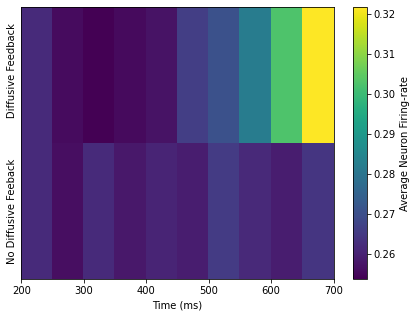

In [ ]:
initialize()

rate_tmp = np.zeros((N,1))
nn = -1

z1 = simulation_with_correlation(False)

initialize()

rate_tmp = np.zeros((N,1))
nn = -1

z2 = simulation_with_correlation(True)

z = np.stack((z1,z2))

plt.figure(figsize=(7,5))
plt.pcolormesh(np.array([200, 250, 300, 350, 400, 450, 500, 550, 600, 650, 700]), np.array([0,1,2]), z)
plt.xlabel("Time (ms)")
plt.ylabel("No Diffusive Feeback             Diffusive Feedback")
plt.yticks([])
colorbar = plt.colorbar()
colorbar.set_label('Average Neuron Firing-rate')

## Histogram Plots

([<matplotlib.axis.XTick at 0x7fd8807c0828>,
 <a list of 11 Text major ticklabel objects>)

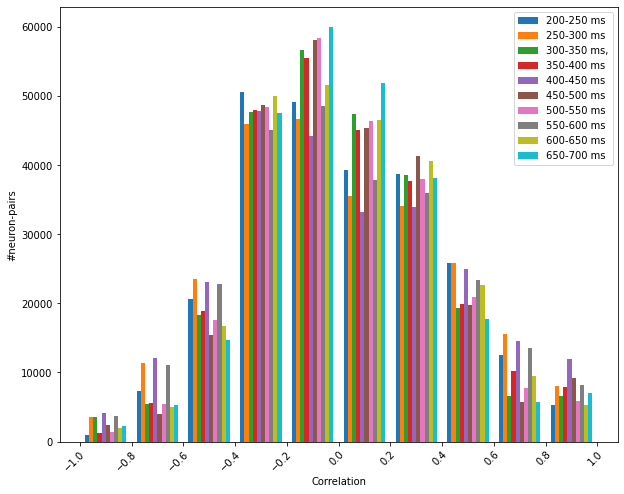

In [ ]:
initialize()

rate_tmp = np.zeros((N,1))
ed_corr = [-1.0, -0.8, -0.6, -0.4, -0.2, 0.0, 0.2, 0.4, 0.6, 0.8, 1.0]

simulation_with_correlation(True)

plt.figure(figsize=(10,8))
plt.hist(corr_hist.T, bins=ed_corr, stacked=False)
plt.legend(['200-250 ms', '250-300 ms', '300-350 ms,', '350-400 ms','400-450 ms','450-500 ms','500-550 ms','550-600 ms','600-650 ms','650-700 ms'])
plt.xlabel("Correlation")
plt.ylabel("#neuron-pairs")
plt.xticks([-1.0, -0.8, -0.6, -0.4, -0.2, 0.0, 0.2, 0.4, 0.6, 0.8, 1.0], rotation=45, rotation_mode="anchor", ha="right")

## Mean Coorelation of all Neurons over Timesteps

[0.17503434548289823, 0.05444397831030622, 0.01778056957163791, 0.02887277268930188, 0.026048176395064498, 0.050493005801589226, 0.028341706579038145, 0.011760314744405994, 0.009404920914025207, 0.029235008841925345, 0.03247844984083707, -0.002337668533308922, 0.025122352663108482, 0.014232876487234387, -0.003427161619806814, 0.019892297752101835, 0.008111861916937645, 0.022919963699716196, 0.019123642327098938, -0.0009635830164339835, 0.005444520871780705, 0.006898896592484273, 0.021306782786333692, 0.0030937103224085998, 0.011075712263862763, 0.029629532451561434, 0.01098295900742891, 0.022237355454704538, 0.02418483880139111, 0.0002426662748112129, 0.016247301945723238, 0.019502443163511556, -0.004867403343372398, 0.014465415217714193, -0.0010254256838575708, 0.013206679126652542, 0.010735698122601094, 0.002278089513693004, 0.012038177017089606, 0.004176121791807427, 0.003068482292225439, 0.005682661378432941, 0.023321197973738623, -0.0008661495955183681, 0.0022458533922190493, 0.02

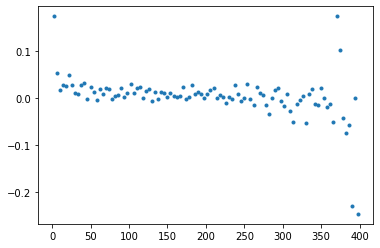

In [ ]:
simulation_with_correlation(True)

dist = DistanceMetric.get_metric('euclidean')
neuron_coordinate[1:3]
neuron_loc = np.zeros((NE,2))
for ii in range(NE):
  neuron_loc[ii,:] = neuron_coordinate[ii]
dd = dist.pairwise(neuron_loc)

dd_flatten = dd.flatten()
rate_corr_NE_flatten = rate_corr[0:NE,0:NE].flatten()

dd_rate_corr = np.stack((dd_flatten, rate_corr_NE_flatten))

intervals = np.arange(0.0, 400.0 + 4, 4)
distance_mid = np.arange(2.0, 398.0 + 4, 4)


filtered = []

for i in range(1, intervals.shape[0]):
  tmp = []
  for j in range(dd_rate_corr.shape[1]):
    if (dd_rate_corr[0, j] > intervals[i - 1] and dd_rate_corr[0, j] < intervals[i]):
      tmp.append(dd_rate_corr[1, j])

  filtered.append(np.mean(tmp))


print(filtered)
print(rate_corr[0:NE,0:NE].shape)
plt.plot(distance_mid, filtered,'.')